In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

plt.rcParams["animation.html"] = "jshtml"

In [2]:


# Functions for dynamics
def alpha_1(theta_1, theta_2):
    return (l2/l1) * (m2/(m1 + m2)) * np.cos(theta_1 - theta_2)

def alpha_2(theta_1, theta_2):
    return (l1/l2) * np.cos(theta_1 - theta_2)

def f1(theta_1, theta_2, w2):
    return -(l2/l1) * (m2/(m1 + m2)) * (w2 ** 2) * np.sin(theta_1 - theta_2) - (g/l1) * np.sin(theta_1)

def f2(theta_1, theta_2, w1):
    return (l1/l2) * (w1 ** 2) * np.sin(theta_1 - theta_2) - (g/l2) * np.sin(theta_2)

def RK_term(t, y, dt, f):
    k1 = dt * f(y, t)
    k2 = dt * f(y + 0.5 * k1, t + 0.5 * dt)
    k3 = dt * f(y + 0.5 * k2, t + 0.5 * dt)
    k4 = dt * f(y + k3, t + dt)
    return (1/6) * (k1 + 2 * k2 + 2 * k3 + k4)

def domega(y, t):
    theta_1, theta_2, w1, w2 = y
    c = 1 / (1 - alpha_1(theta_1, theta_2) * alpha_2(theta_1, theta_2))
    g1 = c * (f1(theta_1, theta_2, w2) - alpha_1(theta_1, theta_2) * f2(theta_1, theta_2, w1))
    g2 = c * (f2(theta_1, theta_2, w1) - alpha_2(theta_1, theta_2) * f1(theta_1, theta_2, w2))
    return np.array([w1, w2, g1, g2])

def T_energy(point):
    theta_1, theta_2, w1, w2 = point
    T = 0.5 * (m1 + m2) * (l1 ** 2) * (w1 ** 2) + 0.5 * m2 * (l2 ** 2) * (w2 ** 2) + m2 * l1 * l2 * w1 * w2 * np.cos(theta_1 - theta_2)
    V = -(m1 + m2) * g * l1 * np.cos(theta_1) - m2 * g * l2 * np.cos(theta_2)
    return T + V

def RK_4_DP():
    y = [y0]
    for i in range(1, N):
        y.append(y[i - 1] + RK_term(t[i - 1], y[i - 1], dt, domega))
    total_energy_rk = np.array([T_energy(p) for p in y])
    return y, total_energy_rk

def Euler_DP():
    y = [y0]
    for i in range(1, N):
        y.append(y[i - 1] + dt * domega(y[i - 1], t[i - 1]))
    total_energy_eu = np.array([T_energy(p) for p in y])
    return y, total_energy_eu

In [3]:
# Parameters (identical for all pendulums)
g = 9.81
l1 = 1.0
l2 = 1.0
m1 = 1.0
m2 = 1.0
K = 0.05  # coupling strength
P = 5     # number of pendulums
T = 60.0
N = 1000
dt = T / N
t = np.linspace(0, T, N)

# --- Dynamics Functions ---

def alpha_1(theta_1, theta_2):
    return (l2 / l1) * (m2 / (m1 + m2)) * np.cos(theta_1 - theta_2)

def alpha_2(theta_1, theta_2):
    return (l1 / l2) * np.cos(theta_1 - theta_2)

def f1(theta_1, theta_2, w2):
    return -(l2 / l1) * (m2 / (m1 + m2)) * (w2 ** 2) * np.sin(theta_1 - theta_2) - (g / l1) * np.sin(theta_1)

def f2(theta_1, theta_2, w1):
    return (l1 / l2) * (w1 ** 2) * np.sin(theta_1 - theta_2) - (g / l2) * np.sin(theta_2)

def domega_lattice(Y, t):
    """
    Computes dY/dt for the coupled pendulum lattice
    Y is a 1D array of shape (P * 4,)
    Returns dYdt of the same shape
    """
    dYdt = np.zeros_like(Y)
    for i in range(P):
        idx = 4 * i
        theta_1, theta_2, w1, w2 = Y[idx:idx + 4]

        a1 = alpha_1(theta_1, theta_2)
        a2 = alpha_2(theta_1, theta_2)
        denom = 1 - a1 * a2
        g1 = (f1(theta_1, theta_2, w2) - a1 * f2(theta_1, theta_2, w1)) / denom
        g2 = (f2(theta_1, theta_2, w1) - a2 * f1(theta_1, theta_2, w2)) / denom

        # Coupling term for theta_1 with neighbors
        coupling = 0
        if i > 0:
            theta_1_prev = Y[4*(i-1)]
            coupling += np.sin(theta_1_prev - theta_1)
        if i < P - 1:
            theta_1_next = Y[4*(i+1)]
            coupling += np.sin(theta_1_next - theta_1)

        # Update the derivatives
        dYdt[idx]     = w1                   # dθ1/dt = ω1
        dYdt[idx + 1] = w2                   # dθ2/dt = ω2
        dYdt[idx + 2] = g1 + K * coupling    # dω1/dt (with coupling)
        dYdt[idx + 3] = g2                   # dω2/dt
    return dYdt

def RK_term(y, t, dt, f):
    k1 = dt * f(y, t)
    k2 = dt * f(y + 0.5 * k1, t + 0.5 * dt)
    k3 = dt * f(y + 0.5 * k2, t + 0.5 * dt)
    k4 = dt * f(y + k3, t + dt)
    return (1/6) * (k1 + 2 * k2 + 2 * k3 + k4)

# --- Initial Conditions ---
np.random.seed(42)
initial_thetas = np.random.uniform(low=0.0, high=np.pi/2, size=(P, 2))  # [theta1, theta2] for each
initial_omegas = np.zeros((P, 2))                                       # [omega1, omega2]
y0 = np.hstack([np.hstack([initial_thetas[i], initial_omegas[i]]) for i in range(P)])

# --- RK4 Integration ---
Y = [y0]
for i in range(1, N):
    Y.append(Y[-1] + RK_term(Y[-1], t[i-1], dt, domega_lattice))
Y = np.array(Y)  # shape (N, P*4)
Y.shape


(1000, 20)

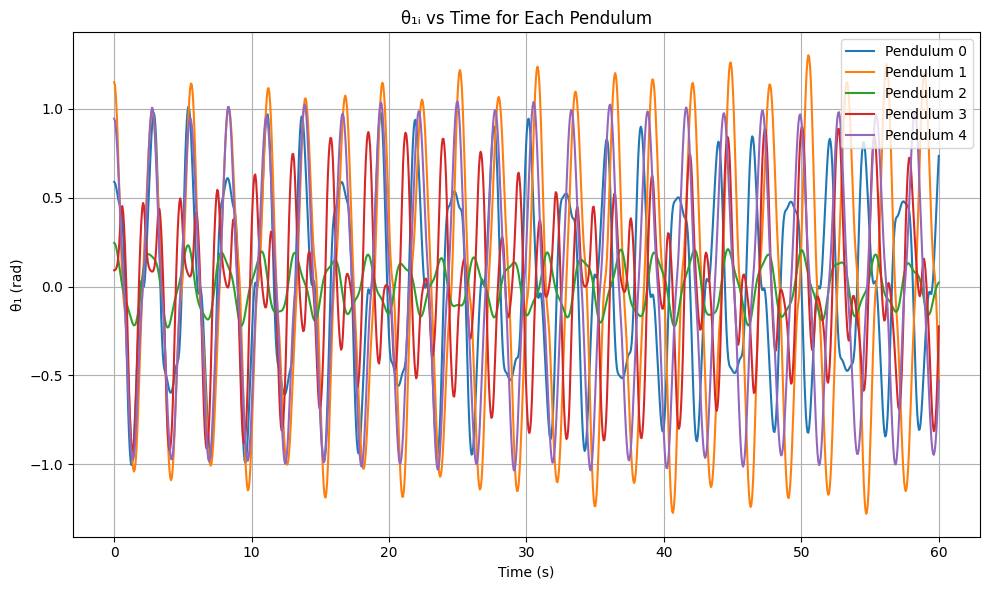

In [4]:

# Extract theta_1 for each pendulum over time
theta_1_all = [Y[:, 4*i] for i in range(P)]  # list of arrays, each shape (1000,)

# --- 1. Plot θ₁ᵢ vs. time for each pendulum ---
plt.figure(figsize=(10, 6))
for i, theta_1 in enumerate(theta_1_all):
    plt.plot(t, theta_1, label=f'Pendulum {i}')
plt.title('θ₁ᵢ vs Time for Each Pendulum')
plt.xlabel('Time (s)')
plt.ylabel('θ₁ (rad)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

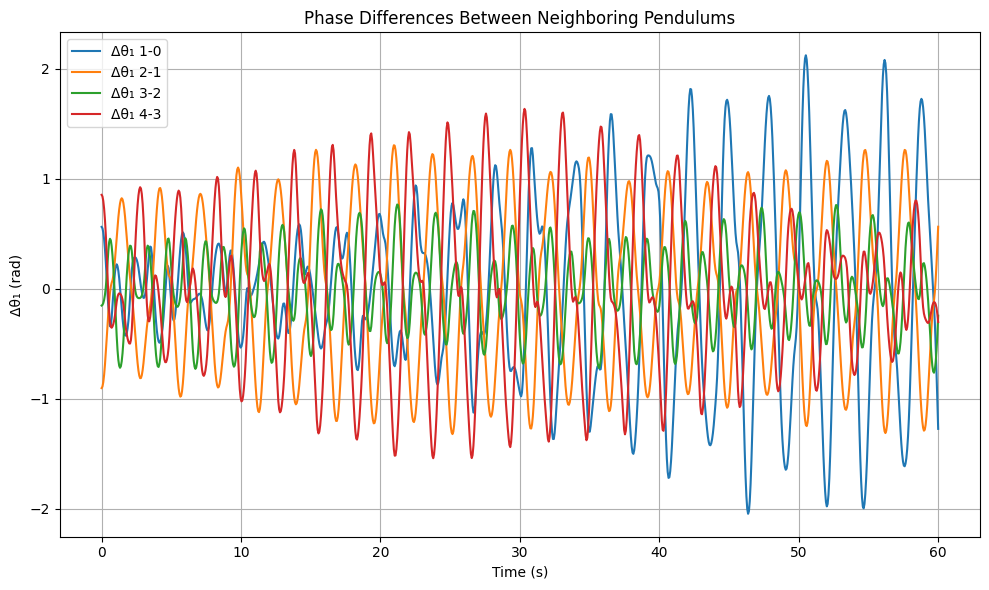

In [5]:

plt.figure(figsize=(10, 6))
for i in range(P - 1):
    delta_theta = theta_1_all[i + 1] - theta_1_all[i]
    plt.plot(t, delta_theta, label=f'Δθ₁ {i+1}-{i}')
plt.title('Phase Differences Between Neighboring Pendulums')
plt.xlabel('Time (s)')
plt.ylabel('Δθ₁ (rad)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


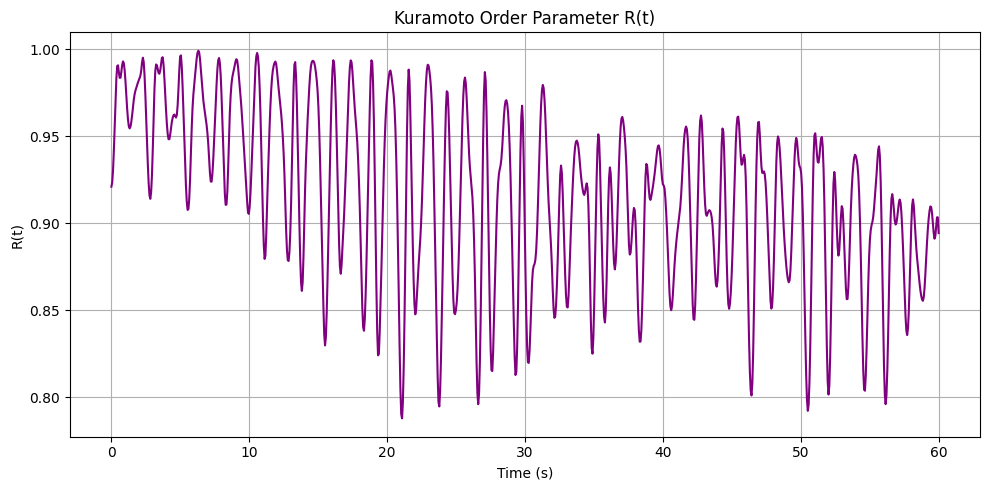

In [6]:
theta_matrix = np.array(theta_1_all)
R_t = np.abs(np.sum(np.exp(1j * theta_matrix), axis=0)) / P

plt.figure(figsize=(10, 5))
plt.plot(t, R_t, color='purple')
plt.title('Kuramoto Order Parameter R(t)')
plt.xlabel('Time (s)')
plt.ylabel('R(t)')
plt.grid(True)
plt.tight_layout()
plt.show()

In [7]:
#generation of the lattice

%matplotlib notebook
import matplotlib
matplotlib.rcParams["animation.html"] = "jshtml"

# coupled_pendulum_kuramoto.py
import numpy as np
import matplotlib.pyplot as plt

# Physical constants
g = 9.81
l1 = 1.0
l2 = 1.0
m1 = 1.0
m2 = 1.0

# Simulation params
P = 20                 # Number of pendulums
T = 60.0               # Total time
dt = 0.01
N = int(T / dt)
t = np.linspace(0, T, N)

# Initial conditions: slight variations
y0_all = []
for i in range(P):
    theta1 = np.pi / 2 + np.random.uniform(-0.1, 0.1)
    theta2 = np.pi / 2 + np.random.uniform(-0.1, 0.1)
    w1 = 0.0
    w2 = 0.0
    y0_all.append(np.array([theta1, theta2, w1, w2]))

# --- Original functions reused ---
def alpha_1(theta_1, theta_2):
    return (l2/l1) * (m2/(m1 + m2)) * np.cos(theta_1 - theta_2)

def alpha_2(theta_1, theta_2):
    return (l1/l2) * np.cos(theta_1 - theta_2)

def f1(theta_1, theta_2, w2):
    return -(l2/l1) * (m2/(m1 + m2)) * (w2 ** 2) * np.sin(theta_1 - theta_2) - (g/l1) * np.sin(theta_1)

def f2(theta_1, theta_2, w1):
    return (l1/l2) * (w1 ** 2) * np.sin(theta_1 - theta_2) - (g/l2) * np.sin(theta_2)

def RK_term(t, y, dt, f):
    k1 = dt * f(y, t)
    k2 = dt * f(y + 0.5 * k1, t + 0.5 * dt)
    k3 = dt * f(y + 0.5 * k2, t + 0.5 * dt)
    k4 = dt * f(y + k3, t + dt)
    return (1/6) * (k1 + 2 * k2 + 2 * k3 + k4)

def T_energy(point):
    theta_1, theta_2, w1, w2 = point
    T = 0.5 * (m1 + m2) * (l1 ** 2) * (w1 ** 2) + 0.5 * m2 * (l2 ** 2) * (w2 ** 2) + m2 * l1 * l2 * w1 * w2 * np.cos(theta_1 - theta_2)
    V = -(m1 + m2) * g * l1 * np.cos(theta_1) - m2 * g * l2 * np.cos(theta_2)
    return T + V

# Modified to support coupling

def domega(y, t):
    raise NotImplementedError("Base domega not used in this context.")

def domega_with_delta(delta_theta):
    return lambda y, t: domega_coupled(y, t, delta_theta)

def domega_coupled(y, t, delta_theta):
    theta_1, theta_2, w1, w2 = y
    c = 1 / (1 - alpha_1(theta_1, theta_2) * alpha_2(theta_1, theta_2))
    g1 = c * (f1(theta_1, theta_2, w2) - alpha_1(theta_1, theta_2) * f2(theta_1, theta_2, w1)) + delta_theta
    g2 = c * (f2(theta_1, theta_2, w1) - alpha_2(theta_1, theta_2) * f1(theta_1, theta_2, w2))
    return np.array([w1, w2, g1, g2])

# Coupling strength
K = 0.5

# RK4 lattice using user-defined RK_term
all_y = [[y.copy()] for y in y0_all]
for i in range(1, N):
    for p in range(P):
        left = all_y[p - 1][i - 1] if p > 0 else all_y[p][i - 1]
        right = all_y[p + 1][i - 1] if p < P - 1 else all_y[p][i - 1]
        delta = K * (np.sin(left[0] - all_y[p][i - 1][0]) + np.sin(right[0] - all_y[p][i - 1][0]))
        all_y[p].append(all_y[p][i - 1] + RK_term(t[i - 1], all_y[p][i - 1], dt, domega_with_delta(delta_theta=delta)))

# Extract theta1 over time
theta1_all = [[all_y[p][i][0] for i in range(N)] for p in range(P)]
delta_theta = [np.array(theta1_all[i+1]) - np.array(theta1_all[i]) for i in range(P - 1)]

# Kuramoto order parameter
R_t = []
for i in range(N):
    phasors = [np.exp(1j * all_y[p][i][0]) for p in range(P)]
    R = np.abs(np.sum(phasors) / P)
    R_t.append(R)

# Visualize lattice evolution
from matplotlib.animation import FuncAnimation

fig_anim, ax_anim = plt.subplots(figsize=(12, 2))
points, = ax_anim.plot([], [], 'o-', markersize=8)
ax_anim.set_xlim(0, P - 1)
ax_anim.set_ylim(-np.pi, np.pi)
ax_anim.set_title("Lattice State: θ₁ᵢ(t)")
ax_anim.set_xlabel("Pendulum Index")
ax_anim.set_ylabel("θ₁ (rad)")

def animate(frame):
    y_vals = [theta1_all[i][frame] for i in range(P)]
    points.set_data(np.arange(P), y_vals)
    return points,

ani = FuncAnimation(fig_anim, animate, frames=N, interval=20, blit=True)


from IPython.display import display, HTML
display(HTML(ani.to_jshtml()))

# Plot
fig, axs = plt.subplots(3, 1, figsize=(12, 10), sharex=True)

for i in range(P):
    axs[0].plot(t, theta1_all[i], label=f"Pendulum {i+1}")
axs[0].set_ylabel("Theta1 (rad)")
axs[0].set_title("Angle \u03b81 over Time")

for i in range(P - 1):
    axs[1].plot(t, delta_theta[i], label=f"Δθ₁^{i+1}-{i}")
axs[1].set_ylabel("Δθ₁")
axs[1].set_title("Phase Differences Between Neighbors")

axs[2].plot(t, R_t, color='black')
axs[2].set_ylabel("R(t)")
axs[2].set_title("Kuramoto Order Parameter")
axs[2].set_xlabel("Time (s)")


plt.tight_layout()
plt.show()


<IPython.core.display.Javascript object>

Animation size has reached 20981523 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


<IPython.core.display.Javascript object>